In [12]:
import numpy as np, pandas as pd
from random import *
from scipy import stats
import matplotlib.pyplot as plt

In [13]:
data = pd.read_csv("data.csv")
data = np.array(data)

In [14]:
#Probability of selecting a thumbnail when shown to participants in the first, second, third, and fourth order
prob = [49/161, 36/161, 42/161, 34/161]

In [15]:
#Set probability intervals between 0 and 1 according to the ratio of prob
ind_1 = prob[0]
ind_2 = ind_1 + prob[1]
ind_3 = ind_2 + prob[2]

#Returns the 1st, 2nd, 3rd, and 4th intervals for a random number
def selection(x):
    if x <= ind_1:
        return 0
    elif x > ind_1 and x <= ind_2:
        return 1
    elif x > ind_2 and x <= ind_3:
        return 2
    else:
        return 3

In [16]:
#simulation function
def simulation(n):
    x_squared = np.zeros(n)
    for N in range(n):
        random = np.random.rand(161)
        choice = []
        for i in range(161):
            s_num = selection(random[i])
            choice.append(data[i][s_num])
            #print(data[i])
            #print("random number: ", random[i], "interval: ", s_num, "final choice", data[i][s_num])
        final_choice = [choice.count('a'), choice.count('b'), choice.count('c'), choice.count('d')]
        exp = 161/4
        x_squared[N] = stats.chisquare(f_obs=final_choice, f_exp = [exp, exp, exp, exp]).statistic
    return x_squared

['a' 'b' 'c' 'd']
random number:  0.8634286636965363 interval:  3 final choice d
['a' 'c' 'd' 'b']
random number:  0.0947770343061013 interval:  0 final choice a
['a' 'b' 'c' 'd']
random number:  0.48294567126122456 interval:  1 final choice b
['a' 'b' 'c' 'd']
random number:  0.021766461160715234 interval:  0 final choice a
['a' 'c' 'b' 'd']
random number:  0.7951162532872842 interval:  3 final choice d
['a' 'c' 'b' 'd']
random number:  0.4036510487317789 interval:  1 final choice c
['a' 'c' 'd' 'b']
random number:  0.686843119469715 interval:  2 final choice d
['a' 'b' 'c' 'd']
random number:  0.9587350821830901 interval:  3 final choice d
['a' 'b' 'c' 'd']
random number:  0.10451618312514399 interval:  0 final choice a
['a' 'c' 'd' 'b']
random number:  0.12998212090587058 interval:  0 final choice a
['a' 'c' 'd' 'b']
random number:  0.6419348255728015 interval:  2 final choice d
['a' 'd' 'b' 'c']
random number:  0.26833642405431757 interval:  0 final choice a
['a' 'd' 'c' 'b']
rando

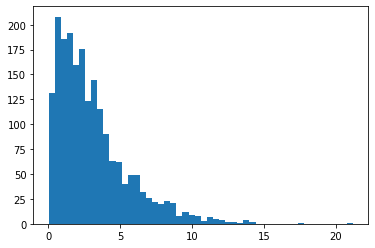

In [11]:
#Run 2000 times
simulation_data = simulation(2000)
plt.hist(simulation_data, bins=50)
filteredList = list(filter(lambda x: x>14.975, simulation_data))
print("The probability that the X-squared value is greater than 14.975 is ", len(filteredList)/2000)